___

<a href="https://lms.clarusway.com/mod/lesson/view.php?id=8511&pageid=8142&startlastseen=no"><img align="left" src="https://i.ibb.co/6Z5pQxD/lmss.png" alt="Open in Clarusway LMS" width="70" height="200" title="Open Clarusway Learning Management Sytem"></a>

<a href=""><img align="right" src="https://i.ibb.co/n3HWyQX/github-logo.png" alt="Open in Clarusway GitHub" width="100" height="150" title="Open and Execute in Clarusway GitHub Repository"></a>

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" 
alt="CLRSWY"></p>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#9d4f8c; font-size:100%; text-align:center; border-radius:10px 10px;">WAY TO REINVENT YOURSELF</p>

<img src=https://i.ibb.co/b5xXg11/used-cars1.jpg width="1100" height="100">

[Image Credit](https://myscriptneedshelp.com/2022/auto/buying-used-cars-in-tempe-is-easier-now/)

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#060108; font-size:200%; text-align:center; border-radius:10px 10px;">The Capstone Project of Data Analytics Module</p>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#060108; font-size:150%; text-align:center; border-radius:10px 10px;">Car Price Prediction EDA</p>

<a id="toc"></a>

## <p style="background-color:#9d4f8c; font-family:newtimeroman; color:#FFF9ED; font-size:175%; text-align:center; border-radius:10px 10px;">Content</p>

* [IMPORTING LIBRARIES NEEDED IN THIS NOTEBOOK](#0)
* [PART-03 (HANDLING WITH OUTLIERS)](#1)
* [THE EXAMINATION OF OUTLIERS IN THE COLUMNS](#2)
* [SOME SPECIFIC OUESTIONS ON ANALYSIS](#3)    
* [DUMMY OPERATION](#4)    
* [THE END OF DATA CLEANING (PART - 03)](#5)

## <p style="background-color:#9d4f8c; font-family:newtimeroman; color:#FFF9ED; font-size:175%; text-align:center; border-radius:10px 10px;">Importing Libraries Needed in This Notebook</p>

<a id="0"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:blue; background-color:#dfa8e4" data-toggle="popover">Content</a>

Once you've installed NumPy, Pandas & other related you can import them as a library:

In [1]:
# !pip install termcolor

In [2]:
# conda install geopandas  # you have to install it at Anaconda Prompt
# conda install -c conda-forge geopy  # you have to install it at Anaconda Prompt
# !pip install shapely
# conda install descartes  
# !pip install descarteslabs[complete]
# !pip install -U scikit-learn

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats.mstats import winsorize
import re

import requests
import geopy
from geopy.geocoders import Nominatim

import warnings
warnings.filterwarnings('ignore')
warnings.warn("this will not show")

%matplotlib inline
# %matplotlib notebook

plt.rcParams["figure.figsize"] = (10, 6)
# plt.rcParams['figure.dpi'] = 100

sns.set_style("whitegrid")
pd.set_option('display.float_format', lambda x: '%.3f' % x)

pd.options.display.max_rows = 2000
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_rows', df.shape[0]+1)
pd.options.display.max_columns = 150

## <p style="background-color:#9d4f8c; font-family:newtimeroman; color:#FFF9ED; font-size:175%; text-align:center; border-radius:10px 10px;">Mapping</p>

<a id="1"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:blue; background-color:#dfa8e4" data-toggle="popover">Content</a>

In [4]:
df0 = pd.read_csv("final_scout_not_dummy2022.csv")
df_map = df0.copy()

In [5]:
df_map.head(3)

,make_model,make,location,price,body_type,type,warranty,mileage,gearbox,fuel_type,seller,engine_size,gears,co_emissions,drivetrain,extras,empty_weight,full_service_history,upholstery,previous_owner,energy_efficiency_class,age,power_kW,cons_avg,comfort_&_convenience_Package,entertainment_&_media_Package,safety_&_security_Package
0,Mercedes-Benz A 160,Mercedes-Benz,"P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SAN...",16950.000,Compact,Used,Yes,120200.000,Manual,Diesel,Dealer,1595.000,5.000,98.000,Front,Alloy wheels,1270.000,No,Cloth,2.000,efficient,6.000,75.000,3.800,Standard,Standard,Safety Premium Package
1,Mercedes-Benz EQE 350,Mercedes-Benz,"APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES",80900.000,Compact,Pre-registered,Yes,5000.000,Automatic,Electric,Dealer,1.000,1.000,0.000,4WD,"Alloy wheels (21""), Shift paddles, Sport packa...",2355.000,No,Part/Full Leather,1.000,efficient,0.000,215.000,2.359,Premium,Plus,Safety Premium Package
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,"PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8...",69900.000,Compact,Used,Yes,18900.000,Automatic,Benzine,Dealer,1991.000,8.000,162.000,4WD,Alloy wheels,1555.000,No,Part/Full Leather,2.000,unefficient,2.000,310.000,8.400,Standard,Standard,Safety Premium Plus Package


In [6]:
df_map.shape

(25087, 27)

In [7]:
df_map.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25087 entries, 0 to 25086
Data columns (total 27 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   make_model                     25087 non-null  object 
 1   make                           25087 non-null  object 
 2   location                       25087 non-null  object 
 3   price                          25087 non-null  float64
 4   body_type                      25087 non-null  object 
 5   type                           25087 non-null  object 
 6   warranty                       25087 non-null  object 
 7   mileage                        25087 non-null  float64
 8   gearbox                        25087 non-null  object 
 9   fuel_type                      25087 non-null  object 
 10  seller                         25087 non-null  object 
 11  engine_size                    25087 non-null  float64
 12  gears                          25087 non-null 

In [8]:
class color:
    PURPLE = '\033[95m'
    CYAN = '\033[96m'
    DARKCYAN = '\033[36m'
    BLUE = '\033[94m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    RED = '\033[91m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'
    END = '\033[0m'

def check_obj_columns(df):
    '''
    Returns NO PROBLEM or column/s which has/have mixed object types.
    '''    
    
    tdf = df.select_dtypes(include=['object']).applymap(type)
    for col in tdf:
        if len(set(tdf[col].values)) > 1:
            print("Column" + " " + color.BOLD + color.RED + col + color.END + " " + "has mixed object types." )
    else:
        if len(set(tdf[col].values)) == 1:
            print(color.BOLD + color.GREEN + " " + "NO PROBLEM" + " " + color.END + " " + "with the data types of Columns in the DataFrame.")

check_obj_columns(df_map)

 NO PROBLEM  with the data types of Columns in the DataFrame.


# Feature Engineering for Latitude & Longitude and Mapping Locations

In [9]:
df_map["location"]

0        P.I. EL PALMAR C/FORJA 6,  11500 PUERTO DE SAN...
1             APARTADO DE CORREOS 1032,  26140 LOGROÑO, ES
2        PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8...
3        Carrer de Provença, 31 Local,  8029 BARCELONA, ES
4                   CARRIL ARAGONES 4,  30007 CASILLAS, ES
                               ...                        
25082             HERMANOS LUMIERE Nº16,  29004 MALAGA, ES
25083                    Stobbeweg 6,  2461 EX TER AAR, NL
25084               Sur rendez-vous,  5060 Sambreville, BE
25085      Bergambachterstraat 5,  2871 JB SCHOONHOVEN, NL
25086                    Lage Ham 106,  5102 AE DONGEN, NL
Name: location, Length: 25087, dtype: object

In [10]:
# To set/expand the maximum width of columns

pd.options.display.max_colwidth = 400

df_map[["location"]]

,location
0,"P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SANTA MARIA, ES"
1,"APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES"
2,"PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8, 43004 TARRAGONA, ES"
3,"Carrer de Provença, 31 Local, 8029 BARCELONA, ES"
4,"CARRIL ARAGONES 4, 30007 CASILLAS, ES"
...,...
25082,"HERMANOS LUMIERE Nº16, 29004 MALAGA, ES"
25083,"Stobbeweg 6, 2461 EX TER AAR, NL"
25084,"Sur rendez-vous, 5060 Sambreville, BE"
25085,"Bergambachterstraat 5, 2871 JB SCHOONHOVEN, NL"


In [11]:
# zip_country_codes['full_location'] 

address = df_map["location"].str.extract(r'(\d{4}\-?\d{0,4}\D+[a-zA-Z\u00C0-\u00FF]+\D+|\d{5}\-?\d{0,5}\D+[a-zA-Z\u00C0-\u00FF]+\D+)')
address.rename(columns={0: "full_location"}, inplace=True)
address

,full_location
0,"11500 PUERTO DE SANTA MARIA, ES"
1,"26140 LOGROÑO, ES"
2,"43004 TARRAGONA, ES"
3,"8029 BARCELONA, ES"
4,"30007 CASILLAS, ES"
...,...
25082,"29004 MALAGA, ES"
25083,"2461 EX TER AAR, NL"
25084,"5060 Sambreville, BE"
25085,"2871 JB SCHOONHOVEN, NL"


**Be carefull** that if you do **NOT** define exact information, unmatched Latitude and Longitude will be provided!!! 

In [12]:
display(address.isnull().sum())
display(address.value_counts(dropna=False))

full_location    0
dtype: int64

full_location                      
28021 MADRID, ES                       306
08097 L'Hospitalet de Llobregat, ES    146
75011 Paris, FR                        142
1000 Brussel, BE                       125
41001 SEVILLA, ES                      117
                                      ... 
3644 Emmersdorf, AT                      1
3648AB Wilnis, NL                        1
36600 Vilagarcia de Arousa, ES           1
36619 Viqueira, ES                       1
4231 DJ MEERKERK, NL                     1
Length: 5730, dtype: int64

In [13]:
address["full_location"].astype(str).str.extract('([0-9]+)')

,0
0,11500
1,26140
2,43004
3,8029
4,30007
...,...
25082,29004
25083,2461
25084,5060
25085,2871


**[regex don't start with 0](https://stackoverflow.com/questions/12365544/regex-dont-start-with-0)**

In [14]:
address["zip_codes"] = address["full_location"].str.extract('([0-9]+)')
address

,full_location,zip_codes
0,"11500 PUERTO DE SANTA MARIA, ES",11500
1,"26140 LOGROÑO, ES",26140
2,"43004 TARRAGONA, ES",43004
3,"8029 BARCELONA, ES",8029
4,"30007 CASILLAS, ES",30007
...,...,...
25082,"29004 MALAGA, ES",29004
25083,"2461 EX TER AAR, NL",2461
25084,"5060 Sambreville, BE",5060
25085,"2871 JB SCHOONHOVEN, NL",2871


In [15]:
country_codes = df_map['location'].str[-2:]
country_codes = pd.DataFrame(country_codes)
country_codes.rename(columns={"location": "country_codes"}, inplace=True)
country_codes

,country_codes
0,ES
1,ES
2,ES
3,ES
4,ES
...,...
25082,ES
25083,NL
25084,BE
25085,NL


In [16]:
display(country_codes.isnull().sum())
display(country_codes.value_counts(dropna=False))

country_codes    0
dtype: int64

country_codes
DE               11348
ES                5985
NL                2286
IT                2039
BE                1591
FR                1298
AT                 510
LU                  29
BG                   1
dtype: int64

In [17]:
# pd.concat([address, country_codes], axis=1)
# address.join(country_codes, how='outer')

zip_country_codes = pd.merge(address, country_codes, left_index=True, right_index=True, how='outer')
zip_country_codes

,full_location,zip_codes,country_codes
0,"11500 PUERTO DE SANTA MARIA, ES",11500,ES
1,"26140 LOGROÑO, ES",26140,ES
2,"43004 TARRAGONA, ES",43004,ES
3,"8029 BARCELONA, ES",8029,ES
4,"30007 CASILLAS, ES",30007,ES
...,...,...,...
25082,"29004 MALAGA, ES",29004,ES
25083,"2461 EX TER AAR, NL",2461,NL
25084,"5060 Sambreville, BE",5060,BE
25085,"2871 JB SCHOONHOVEN, NL",2871,NL


In [18]:
cols = ["zip_codes", "country_codes"]
zip_country_codes["zip_country"] = zip_country_codes[cols].apply(lambda row: ', '.join(row.values.astype(str)), axis=1)
zip_country_codes

# zip_country_codes["zip_codes"].str.cat(zip_country_codes[["country_codes"]].astype(str), sep=", ")
# zip_country_codes['zip_codes'].astype(str) + ', ' + zip_country_codes['country_codes'].astype(str)

,full_location,zip_codes,country_codes,zip_country
0,"11500 PUERTO DE SANTA MARIA, ES",11500,ES,"11500, ES"
1,"26140 LOGROÑO, ES",26140,ES,"26140, ES"
2,"43004 TARRAGONA, ES",43004,ES,"43004, ES"
3,"8029 BARCELONA, ES",8029,ES,"8029, ES"
4,"30007 CASILLAS, ES",30007,ES,"30007, ES"
...,...,...,...,...
25082,"29004 MALAGA, ES",29004,ES,"29004, ES"
25083,"2461 EX TER AAR, NL",2461,NL,"2461, NL"
25084,"5060 Sambreville, BE",5060,BE,"5060, BE"
25085,"2871 JB SCHOONHOVEN, NL",2871,NL,"2871, NL"


In [19]:
display(zip_country_codes["zip_country"].isnull().sum())
display(zip_country_codes["zip_country"].value_counts(dropna=False))

0

28021, ES    306
08097, ES    146
75011, FR    142
1000, BE     129
41500, ES    128
            ... 
8232, AT       1
30319, ES      1
50125, IT      1
30982, DE      1
2521, NL       1
Name: zip_country, Length: 4765, dtype: int64

**[Post Codes](https://github.com/unicode-org/cldr/blob/release-26-0-1/common/supplemental/postalCodeData.xml)**

### How to generate lat/long points from address

In [20]:
# !pip install geopy --user
# conda install -c conda-forge geopy

In [21]:
# Sample of How Geopy Works

# import pandas as pd
# from geopy.geocoders import Nominatim

# geolocator = Nominatim(user_agent="myApp")

# df2 = pd.DataFrame({'Location':
#             ['2094 Valentine Avenue,Bronx,NY,10457',
#              '1123 East Tremont Avenue,Bronx,NY,10460',
#              '412 Macon Street,Brooklyn,NY,11233']})

# df2[['location_lat', 'location_long']] = df2['Location'].apply(
#     geolocator.geocode).apply(lambda x: pd.Series(
#         [x.latitude, x.longitude], index=['location_lat', 'location_long']))

# df2

In [22]:
# geolocator = Nominatim(user_agent="myApp")

# df_map['location'][:10].apply(geolocator.geocode).apply(lambda x: pd.Series([x.latitude, x.longitude], index=['location_lat', 'location_long']))

# If the address is NOT on geopy database, geopy will raise AttributeError: 'NoneType' object has no attribute 'latitude'

The **problem** here is that we are trying to get 'latitude' and 'longitude' from a None object. Basically doing None.latitude. This is the intended behavior when the Nominatim service doesn't return a result to geopy. So the best way to go through this is to first check if the geocoder returns a value before we try to access the 'longitude' and 'latitude'. **[Source](https://www.appsloveworld.com/pandas/100/129/python-pandas-geopyattributeerror-nonetype-object-has-no-attribute-latitude)**. Besides, Nominatim doesn't like bulk queries, so, in this case, the suggestion is that make sure you only query unique items. Otherwie, repeated queries for the same latitude-longitude combination is blocked by Nominatim. The same can be true for addresses. Therefore you can either use unq_address = df['address'].unique() and then make a query using that series or even end up with less addresses **[Source](https://stackoverflow.com/questions/60083187/python-geopy-nominatim-too-many-requests)**.  

In [23]:
from geopy.geocoders import Nominatim

geolocator = Nominatim(user_agent="GetLoc")

first_10 = zip_country_codes["zip_country"][:10].apply(geolocator.geocode).apply(lambda x: pd.Series([x.latitude, x.longitude], index=['location_lat', 'location_long']))
first_10

,location_lat,location_long
0,36.596,-6.231
1,42.428,-2.460
2,41.112,1.251
3,-20.254,-40.268
4,37.999,-1.122
5,51.170,7.062
6,39.531,-0.447
7,41.636,-0.931
8,50.930,5.337
9,43.490,-5.726


### 🔥 IMPORTANT NOTE: The code giving ``"Latitude"`` & ``"Longitude"`` and included in the following three (3) cells will ``NOT`` be run since it takes a couple of hours!!! It was run before and the ouput was saved as DataFrame named ``"raw_coordsV02.csv"`` which will be shared with you. 🔥

In [24]:
# from geopy.geocoders import Nominatim
# from geopy.exc import GeocoderTimedOut

# lat = []
# long = []
# for row in zip_country_codes["full_location"]:
#     addr = geolocator.geocode(row, timeout=10)
#     if addr is None:
#         lat.append(None)
#         long.append(None)
#     else:
#         latitude = addr.latitude
#         longitude = addr.longitude  
    
#     lat.append(latitude)
#     long.append(longitude)
    
# print(lat)    
# print(long)    

In [25]:
# print(sum(x is not None for x in lat))

# latitude = [i for i in lat if i is not None]
# print(latitude)

# print(sum(x is not None for x in latitude))

# zip_country_codes['latitude'] = latitude

In [26]:
# print(sum(x is not None for x in long))

# longitude = [i for i in long if i is not None]
# print(longitude)

# print(sum(x is not None for x in longitude))

# zip_country_codes['longitude'] = longitude

In [27]:
# zip_country_codes.to_csv("raw_coordsV02.csv", index=False)

In [28]:
pd.set_option('display.float_format', lambda x: '%.15f' % x)

coords = pd.read_csv("raw_coordsV02.csv")
coords

,full_location,zip_codes,country_codes,zip_country,latitude,longitude
0,"11500 PUERTO DE SANTA MARIA, ES",11500,ES,"11500, ES",38.689065599999999,0.144329500000000
1,"26140 LOGROÑO, ES",26140,ES,"26140, ES",42.427832690000002,-2.460464040000000
2,"43004 TARRAGONA, ES",43004,ES,"43004, ES",41.112083956249997,1.250905206250000
3,"8029 BARCELONA, ES",8029,ES,"8029, ES",37.706176200000002,-2.935187600000000
4,"30007 CASILLAS, ES",30007,ES,"30007, ES",40.064069099999998,-6.661044900000000
...,...,...,...,...,...,...
25082,"29004 MALAGA, ES",29004,ES,"29004, ES",36.684959752584120,-4.467507040959588
25083,"2461 EX TER AAR, NL",2461,NL,"2461, NL",52.178535855813962,4.709866323255814
25084,"5060 Sambreville, BE",5060,BE,"5060, BE",50.441944524621043,4.617766296505505
25085,"2871 JB SCHOONHOVEN, NL",2871,NL,"2871, NL",51.955347607692310,4.844402323076923


In [29]:
coords.isnull().sum()

full_location    0
zip_codes        0
country_codes    0
zip_country      0
latitude         0
longitude        0
dtype: int64

In [30]:
coords.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25087 entries, 0 to 25086
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   full_location  25087 non-null  object 
 1   zip_codes      25087 non-null  int64  
 2   country_codes  25087 non-null  object 
 3   zip_country    25087 non-null  object 
 4   latitude       25087 non-null  float64
 5   longitude      25087 non-null  float64
dtypes: float64(2), int64(1), object(3)
memory usage: 1.1+ MB


In [31]:
df_map.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25087 entries, 0 to 25086
Data columns (total 27 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   make_model                     25087 non-null  object 
 1   make                           25087 non-null  object 
 2   location                       25087 non-null  object 
 3   price                          25087 non-null  float64
 4   body_type                      25087 non-null  object 
 5   type                           25087 non-null  object 
 6   warranty                       25087 non-null  object 
 7   mileage                        25087 non-null  float64
 8   gearbox                        25087 non-null  object 
 9   fuel_type                      25087 non-null  object 
 10  seller                         25087 non-null  object 
 11  engine_size                    25087 non-null  float64
 12  gears                          25087 non-null 

In [32]:
df_map = pd.merge(df_map, coords[['full_location', 'zip_country', 'latitude', 'longitude']], left_index=True, right_index=True, how='left')
df_map

,make_model,make,location,price,body_type,type,warranty,mileage,gearbox,fuel_type,seller,engine_size,gears,co_emissions,drivetrain,extras,empty_weight,full_service_history,upholstery,previous_owner,energy_efficiency_class,age,power_kW,cons_avg,comfort_&_convenience_Package,entertainment_&_media_Package,safety_&_security_Package,full_location,zip_country,latitude,longitude
0,Mercedes-Benz A 160,Mercedes-Benz,"P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SANTA MARIA, ES",16950.000000000000000,Compact,Used,Yes,120200.000000000000000,Manual,Diesel,Dealer,1595.000000000000000,5.000000000000000,98.000000000000000,Front,Alloy wheels,1270.000000000000000,No,Cloth,2.000000000000000,efficient,6.000000000000000,75.000000000000000,3.800000000000000,Standard,Standard,Safety Premium Package,"11500 PUERTO DE SANTA MARIA, ES","11500, ES",38.689065599999999,0.144329500000000
1,Mercedes-Benz EQE 350,Mercedes-Benz,"APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES",80900.000000000000000,Compact,Pre-registered,Yes,5000.000000000000000,Automatic,Electric,Dealer,1.000000000000000,1.000000000000000,0.000000000000000,4WD,"Alloy wheels (21""), Shift paddles, Sport package, Sport seats, Touch screen, Voice Control",2355.000000000000000,No,Part/Full Leather,1.000000000000000,efficient,0.000000000000000,215.000000000000000,2.359000000000000,Premium,Plus,Safety Premium Package,"26140 LOGROÑO, ES","26140, ES",42.427832690000002,-2.460464040000000
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,"PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8, 43004 TARRAGONA, ES",69900.000000000000000,Compact,Used,Yes,18900.000000000000000,Automatic,Benzine,Dealer,1991.000000000000000,8.000000000000000,162.000000000000000,4WD,Alloy wheels,1555.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,2.000000000000000,310.000000000000000,8.400000000000000,Standard,Standard,Safety Premium Plus Package,"43004 TARRAGONA, ES","43004, ES",41.112083956249997,1.250905206250000
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,"Carrer de Provença, 31 Local, 8029 BARCELONA, ES",46990.000000000000000,Compact,Used,Yes,18995.000000000000000,Automatic,Benzine,Dealer,1991.000000000000000,7.000000000000000,169.000000000000000,4WD,Sport seats,1455.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,2.000000000000000,225.000000000000000,7.300000000000000,Standard,Standard,Safety Premium Package,"8029 BARCELONA, ES","8029, ES",37.706176200000002,-2.935187600000000
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,"CARRIL ARAGONES 4, 30007 CASILLAS, ES",16800.000000000000000,Compact,Used,Yes,197000.000000000000000,Automatic,Diesel,Dealer,2143.000000000000000,7.000000000000000,162.000000000000000,4WD,Alloy wheels,1545.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,7.000000000000000,100.000000000000000,4.900000000000000,Standard,Standard,Safety Premium Plus Package,"30007 CASILLAS, ES","30007, ES",40.064069099999998,-6.661044900000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25082,Volvo S90,Volvo,"HERMANOS LUMIERE Nº16, 29004 MALAGA, ES",37600.000000000000000,Sedan,Used,Yes,40345.000000000000000,Automatic,Diesel,Dealer,1969.000000000000000,8.000000000000000,127.000000000000000,4WD,Alloy wheels,2077.000000000000000,No,Part/Full Leather,2.000000000000000,efficient,3.000000000000000,288.000000000000000,2.000000000000000,Standard,Standard,Safety Premium Plus Package,"29004 MALAGA, ES","29004, ES",36.684959752584120,-4.467507040959588
25083,Volvo S40,Volvo,"Stobbeweg 6, 2461 EX TER AAR, NL",5499.000000000000000,Sedan,Used,No,145000.000000000000000,Automatic,Benzine,Dealer,2435.000000000000000,5.000000000000000,217.000000000000000,Front,"Alloy wheels (16""), Trailer hitch",1357.000000000000000,Yes,Cloth,3.000000000000000,efficient,18.000000000000000,125.000000000000000,9.100000000000000,Standard,Standard,Safety Standard Package,"2461 EX TER AAR, NL","2461, NL",52.178535855813962,4.709866323255814
25084,Volvo C3

In [33]:
# pop() method works for a single column and returns a Series
full_location = df_map.pop("full_location")
zip_country = df_map.pop("zip_country")
latitude = df_map.pop("latitude")
longitude = df_map.pop("longitude")

# Let's insert the columns we have popped
df_map.insert(3, "full_location", full_location)
df_map.insert(4, "zip_country", zip_country)
df_map.insert(5, "latitude", latitude)
df_map.insert(6, "longitude", longitude)

df_map

,make_model,make,location,full_location,zip_country,latitude,longitude,price,body_type,type,warranty,mileage,gearbox,fuel_type,seller,engine_size,gears,co_emissions,drivetrain,extras,empty_weight,full_service_history,upholstery,previous_owner,energy_efficiency_class,age,power_kW,cons_avg,comfort_&_convenience_Package,entertainment_&_media_Package,safety_&_security_Package
0,Mercedes-Benz A 160,Mercedes-Benz,"P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SANTA MARIA, ES","11500 PUERTO DE SANTA MARIA, ES","11500, ES",38.689065599999999,0.144329500000000,16950.000000000000000,Compact,Used,Yes,120200.000000000000000,Manual,Diesel,Dealer,1595.000000000000000,5.000000000000000,98.000000000000000,Front,Alloy wheels,1270.000000000000000,No,Cloth,2.000000000000000,efficient,6.000000000000000,75.000000000000000,3.800000000000000,Standard,Standard,Safety Premium Package
1,Mercedes-Benz EQE 350,Mercedes-Benz,"APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES","26140 LOGROÑO, ES","26140, ES",42.427832690000002,-2.460464040000000,80900.000000000000000,Compact,Pre-registered,Yes,5000.000000000000000,Automatic,Electric,Dealer,1.000000000000000,1.000000000000000,0.000000000000000,4WD,"Alloy wheels (21""), Shift paddles, Sport package, Sport seats, Touch screen, Voice Control",2355.000000000000000,No,Part/Full Leather,1.000000000000000,efficient,0.000000000000000,215.000000000000000,2.359000000000000,Premium,Plus,Safety Premium Package
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,"PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8, 43004 TARRAGONA, ES","43004 TARRAGONA, ES","43004, ES",41.112083956249997,1.250905206250000,69900.000000000000000,Compact,Used,Yes,18900.000000000000000,Automatic,Benzine,Dealer,1991.000000000000000,8.000000000000000,162.000000000000000,4WD,Alloy wheels,1555.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,2.000000000000000,310.000000000000000,8.400000000000000,Standard,Standard,Safety Premium Plus Package
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,"Carrer de Provença, 31 Local, 8029 BARCELONA, ES","8029 BARCELONA, ES","8029, ES",37.706176200000002,-2.935187600000000,46990.000000000000000,Compact,Used,Yes,18995.000000000000000,Automatic,Benzine,Dealer,1991.000000000000000,7.000000000000000,169.000000000000000,4WD,Sport seats,1455.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,2.000000000000000,225.000000000000000,7.300000000000000,Standard,Standard,Safety Premium Package
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,"CARRIL ARAGONES 4, 30007 CASILLAS, ES","30007 CASILLAS, ES","30007, ES",40.064069099999998,-6.661044900000000,16800.000000000000000,Compact,Used,Yes,197000.000000000000000,Automatic,Diesel,Dealer,2143.000000000000000,7.000000000000000,162.000000000000000,4WD,Alloy wheels,1545.000000000000000,No,Part/Full Leather,2.000000000000000,unefficient,7.000000000000000,100.000000000000000,4.900000000000000,Standard,Standard,Safety Premium Plus Package
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25082,Volvo S90,Volvo,"HERMANOS LUMIERE Nº16, 29004 MALAGA, ES","29004 MALAGA, ES","29004, ES",36.684959752584120,-4.467507040959588,37600.000000000000000,Sedan,Used,Yes,40345.000000000000000,Automatic,Diesel,Dealer,1969.000000000000000,8.000000000000000,127.000000000000000,4WD,Alloy wheels,2077.000000000000000,No,Part/Full Leather,2.000000000000000,efficient,3.000000000000000,288.000000000000000,2.000000000000000,Standard,Standard,Safety Premium Plus Package
25083,Volvo S40,Volvo,"Stobbeweg 6, 2461 EX TER AAR, NL","2461 EX TER AAR, NL","2461, NL",52.178535855813962,4.709866323255814,5499.000000000000000,Sedan,Used,No,145000.000000000000000,Automatic,Benzine,Dealer,2435.000000000000000,5.000000000000000,217.000000000000000,Front,"Alloy wheels (16""), Trailer hitch",1357.000000000000000,Yes,Cloth,3.000000000000000,efficient,18.000000000000000,125.000000000000000,9.100000000000000,Standard,Standard,Safety Standard Package
25084,Volvo C3

In [34]:
df_map.isnull().sum()

make_model                       0
make                             0
location                         0
full_location                    0
zip_country                      0
latitude                         0
longitude                        0
price                            0
body_type                        0
type                             0
warranty                         0
mileage                          0
gearbox                          0
fuel_type                        0
seller                           0
engine_size                      0
gears                            0
co_emissions                     0
drivetrain                       0
extras                           0
empty_weight                     0
full_service_history             0
upholstery                       0
previous_owner                   0
energy_efficiency_class          0
age                              0
power_kW                         0
cons_avg                         0
comfort_&_convenienc

In [35]:
df_map.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25087 entries, 0 to 25086
Data columns (total 31 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   make_model                     25087 non-null  object 
 1   make                           25087 non-null  object 
 2   location                       25087 non-null  object 
 3   full_location                  25087 non-null  object 
 4   zip_country                    25087 non-null  object 
 5   latitude                       25087 non-null  float64
 6   longitude                      25087 non-null  float64
 7   price                          25087 non-null  float64
 8   body_type                      25087 non-null  object 
 9   type                           25087 non-null  object 
 10  warranty                       25087 non-null  object 
 11  mileage                        25087 non-null  float64
 12  gearbox                        25087 non-null 

### Mapping with Bokeh

In [36]:
# !pip install pandas-bokeh
# !pip install pgeocode
# !pip install geopandas

Loading BokehJS ...

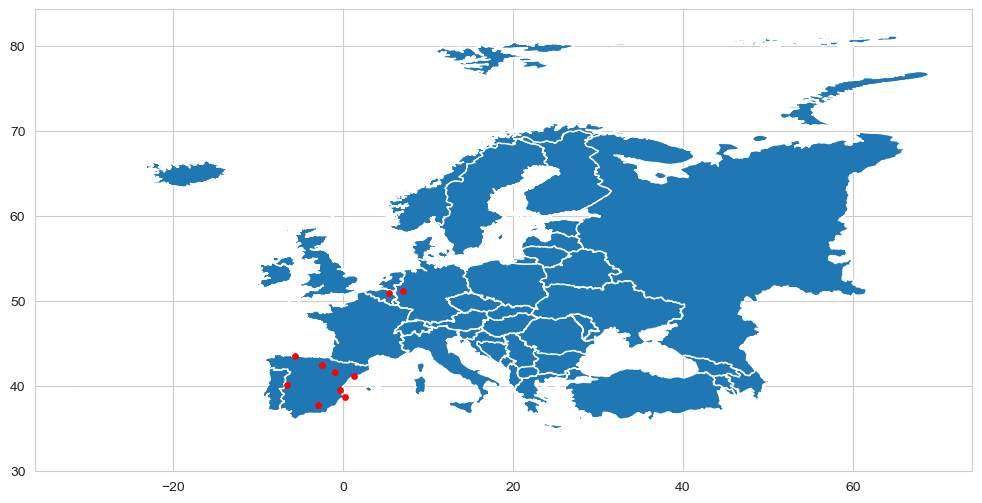

In [37]:
import pandas as pd
import pandas_bokeh
import matplotlib.pyplot as plt
import pgeocode
import geopandas as gpd
from shapely.geometry import Point
from geopandas import GeoDataFrame
pandas_bokeh.output_notebook()
import plotly.graph_objects as go

nomi = pgeocode.Nominatim('DE')

# df_map['Latitude'] = (nomi.query_postal_code(df_map['full_location'].tolist()).latitude)
# df_map['Longitude'] = (nomi.query_postal_code(df_map['full_location'].tolist()).longitude)

geometry = [Point(xy) for xy in zip(df_map['longitude'][:10], df_map['latitude'][:10])]
gdf_map = GeoDataFrame(df_map[:10], geometry=geometry)

eu = r"C:\Users\hp\Desktop\DS Teaching Materials\DA-DV Cohort Materials\01.DA\Projects\Capstone (AutoScout_2022)\Europe\Europe.shp"
europe = gpd.read_file(eu)
gdf_map.plot(ax=europe.plot(figsize=(20, 6)), marker='o', color='red', markersize=15);

``Bokeh`` is a powerful high performance Python visualization library that makes D3-like interactive web plotting easy.

In [38]:
from bokeh.io import output_file, output_notebook, show
from bokeh.plotting import figure, ColumnDataSource
output_notebook()

from bokeh.models import (Range1d, GeoJSONDataSource, HoverTool, 
                          LinearColorMapper, GMapPlot, GMapOptions, 
                          ColumnDataSource, Circle, DataRange1d, PanTool, WheelZoomTool, BoxSelectTool)


Vehicle_Source = ColumnDataSource(data=dict(x=df_map['longitude'],
                                            y=df_map['latitude'],
                                            price=df_map['price'].values,
                                            name=df_map['make_model'].values,
                                            location=df_map['full_location'].values))


TOOLS = "pan, wheel_zoom, box_zoom, reset, hover, save" 

Elevated = figure(title="Cars for Sale", 
                tools=TOOLS,
                x_axis_location=None, 
                y_axis_location=None) 

Elevated.circle('x', 'y', source=Vehicle_Source, size=4)

hover = Elevated.select_one(HoverTool)
hover.point_policy = "follow_mouse"

hover.tooltips = [("Make & Model", "@name"),
                  ("Price.", "@price"),
                  ("Location.", "@location"),
                  ("(Long, Lat)", "($x, $y)")]

show(Elevated)

Loading BokehJS ...

### Mapping with GeoPandas

In [39]:
# !pip install folium matplotlib mapclassify

**Let us explore which maps there haave been in GeoPandas Library:**

In [40]:
import geopandas

nybb = geopandas.read_file(geopandas.datasets.get_path('nybb'))
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
cities = geopandas.read_file(geopandas.datasets.get_path('naturalearth_cities'))

cities.explore()

**Let us create a GeoDataFrame:**

In [41]:
import geopandas
import folium

location = df_map['latitude'].mean(), df_map['longitude'].mean()
m = folium.Map(location=location, zoom_start=4)

# Create point geometries
geometry = geopandas.points_from_xy(df_map.longitude, df_map.latitude)
geo_df_map = geopandas.GeoDataFrame(df_map[["full_location", "make_model", "type", "price", "latitude", "longitude"]], 
                                geometry=geometry)

geo_df_map.head()

,full_location,make_model,type,price,latitude,longitude,geometry
0,"11500 PUERTO DE SANTA MARIA, ES",Mercedes-Benz A 160,Used,16950.000000000000000,38.689065599999999,0.144329500000000,POINT (0.14433 38.68907)
1,"26140 LOGROÑO, ES",Mercedes-Benz EQE 350,Pre-registered,80900.000000000000000,42.427832690000002,-2.460464040000000,POINT (-2.46046 42.42783)
2,"43004 TARRAGONA, ES",Mercedes-Benz A 45 AMG,Used,69900.000000000000000,41.112083956249997,1.250905206250000,POINT (1.25091 41.11208)
3,"8029 BARCELONA, ES",Mercedes-Benz A 35 AMG,Used,46990.000000000000000,37.706176200000002,-2.935187600000000,POINT (-2.93519 37.70618)
4,"30007 CASILLAS, ES",Mercedes-Benz A 45 AMG,Used,16800.000000000000000,40.064069099999998,-6.661044900000000,POINT (-6.66104 40.06407)


**Let us demonsrate our points (latitudes & longitudes) on a map:**

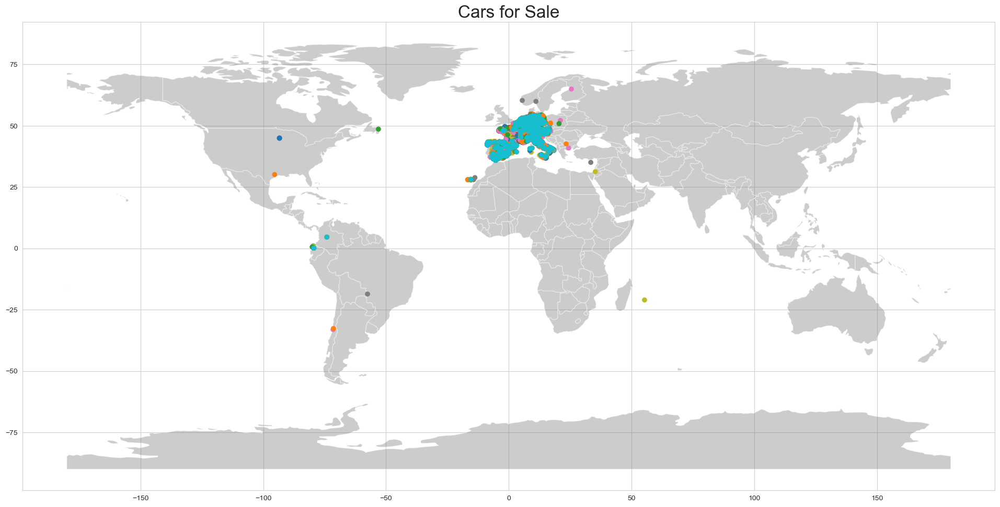

In [42]:
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))

fig, ax = plt.subplots(figsize=(24, 20))
world.plot(ax=ax, alpha=0.4, color="grey")
geo_df_map.plot(column="make_model", ax=ax, legend=False)
plt.title("Cars for Sale", fontsize=24);

**However, the map is still NOT interactive and could NOT give some information we desire!!!. Let's do it interactive**

### Interactive Mapping with Folium

In [43]:
# Folium with OpenStreetMap

# Folium has a number of built-in tilesets from OpenStreetMap, Mapbox, and Stamen, such as "OpenStreetMap", "Stamen Toner", "Stamen Terrain", "Cartodb dark_matter":

location = geo_df_map['latitude'].mean(), geo_df_map['longitude'].mean()

map = folium.Map(location=location, tiles="OpenStreetMap", zoom_start=6)

map

In [44]:
# Create a world map to show the vehicles for sale 
import folium
from folium.plugins import MarkerCluster

# Creating an empty map
location = geo_df_map['latitude'].mean(), geo_df_map['longitude'].mean()
map = folium.Map(location=location, tiles="OpenStreetMap", zoom_start=5)
marker_cluster = MarkerCluster().add_to(map)

# For each coordinate, create circlemarker of user percent
for i in range(len(geo_df_map)):
        lat = geo_df_map.iloc[i]['latitude']
        long = geo_df_map.iloc[i]['longitude']
        radius=5

        folium.CircleMarker(location=[lat, long], radius=radius, fill=True).add_to(marker_cluster)
        
# show the map
map

In [45]:
geo_df_map100 = geo_df_map.iloc[:100]
geo_df_map100

,full_location,make_model,type,price,latitude,longitude,geometry
0,"11500 PUERTO DE SANTA MARIA, ES",Mercedes-Benz A 160,Used,16950.000000000000000,38.689065599999999,0.144329500000000,POINT (0.14433 38.68907)
1,"26140 LOGROÑO, ES",Mercedes-Benz EQE 350,Pre-registered,80900.000000000000000,42.427832690000002,-2.460464040000000,POINT (-2.46046 42.42783)
2,"43004 TARRAGONA, ES",Mercedes-Benz A 45 AMG,Used,69900.000000000000000,41.112083956249997,1.250905206250000,POINT (1.25091 41.11208)
3,"8029 BARCELONA, ES",Mercedes-Benz A 35 AMG,Used,46990.000000000000000,37.706176200000002,-2.935187600000000,POINT (-2.93519 37.70618)
4,"30007 CASILLAS, ES",Mercedes-Benz A 45 AMG,Used,16800.000000000000000,40.064069099999998,-6.661044900000000,POINT (-6.66104 40.06407)
5,"42655 Solingen, DE",Mercedes-Benz C 160,Used,4690.000000000000000,51.169896284673968,7.061947453807711,POINT (7.06195 51.16990)
6,"46980 PATERNA, ES",Mercedes-Benz CLA 180,Used,22550.000000000000000,39.530974117777774,-0.446230515555555,POINT (-0.44623 39.53097)
7,"50012 ZARAGOZA, ES",Mercedes-Benz A 220,Used,26900.000000000000000,41.636477317305832,-0.931024631517886,POINT (-0.93102 41.63648)
8,"3500 Hasselt, BE",Mercedes-Benz A 35 AMG,Used,44999.000000000000000,50.929287748457853,5.326659407539410,POINT (5.32666 50.92929)
9,"33392 GIJON, ES",Mercedes-Benz A 200,Used,23900.000000000000000,43.499065649999999,-5.704951275000000,POINT (-5.70495 43.49907)


In [46]:
# Creating Basemap

my_map = folium.Map(location=[geo_df_map100['latitude'].mean(), geo_df_map100['longitude'].mean()], zoom_start=5, width=960, height=550)

# For each coordinate, create a point/marker
for i in range(len(geo_df_map100)):
        lat = geo_df_map100.iloc[i]['latitude']
        long = geo_df_map100.iloc[i]['longitude']
        profiles = ''
        for info in geo_df_map100.loc[i, ['make_model','type','price']]:
            item = '<{0}>{1}</{0}>'.format('li', info)
            profiles += item        
            html=f"""
            <h2>{geo_df_map100.iloc[i]['full_location']}</h2>
            <p>Car Information:</p> 
            <ul>
            {profiles}
            </ul>
            """        
        iframe = folium.IFrame(html=html, width=250, height=165)
        popup = folium.Popup(iframe, max_width=2650)
        folium.Marker(location=[lat, long], 
                      tooltip='Click here to see Car for Sale', 
                      radius=5,
                      popup=popup).add_to(my_map) 
                      
                      
# Adding additional user selection map layers
folium.TileLayer('OpenStreetMap').add_to(my_map)
folium.TileLayer('Stamen Terrain').add_to(my_map)
folium.TileLayer('Stamen Toner').add_to(my_map)
folium.TileLayer('Stamen Water Color').add_to(my_map)
folium.TileLayer('cartodbpositron').add_to(my_map)
folium.TileLayer('cartodbdark_matter').add_to(my_map)
folium.LayerControl().add_to(my_map)

my_map

### Interactive Mapping with Plotly

In case Plotly chart not showing in Jupyter notebook, run the following code:

    import plotly.io as pio
    pio.renderers.default='notebook'

In [47]:
# import plotly.graph_objects as go

# fig = go.Figure(go.Scattergeo())
# fig.update_geos(projection_type="natural earth")
# fig.update_layout(height=300, margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()

# import plotly.graph_objects as go

# fig = go.Figure(go.Scattergeo())
# fig.update_geos(
#     visible=False, resolution=50,
#     showcountries=True, countrycolor="RebeccaPurple"
# )
# fig.update_layout(height=300, margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()

# import plotly.express as px

# fig = px.scatter(geo_df_map, x="longitude", y="latitude", hover_name="make_model", width=1200, height=600)

# fig.show()


import plotly.express as px

fig = px.density_mapbox(geo_df_map,
                        lat='latitude',
                        lon='longitude',
                        hover_data=['full_location', 'make_model', 'type', 'price'],
                        range_color = [0, 200],
#                         mapbox_style='open-street-map'                        
                        zoom=4,
                        radius=10,
                        opacity=1)

fig.update_layout(margin={'l':0,'t':0,'b':0,'r':0},
                  mapbox={'center': {'lon': 8.5, 'lat': 47},
                          'style': "open-street-map",
                          'zoom': 4},
                  width=1600,
                  height=650)

fig.show()

In [48]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Scattermapbox(mode="markers",
                               lat=geo_df_map.latitude.tolist(),
                               lon=geo_df_map.longitude.tolist(),
                               text="Location: " + geo_df_map["full_location"] + 
                                    "<br>Make & Model: " + geo_df_map["make_model"] +
                                    "<br>Type: " + geo_df_map["type"] + 
                                    "<br>Price: " + geo_df_map["price"].astype(str) + " €",
                               marker={'color': "red", 
                                        "size": 10}))

fig.update_layout(hoverlabel=dict(font_color="blue",
                                  bgcolor="white"))

fig.update_layout(margin={'l':0,'t':0,'b':0,'r':0},
                  mapbox={'center': {'lon': 8.5, 'lat': 47},
                          'style': "stamen-terrain",
                          'zoom': 4},
                  width=1600,
                  height=650)
fig.show()

<a id="10"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:blue; background-color:#dfa8e4" data-toggle="popover">Content</a>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#9d4f8c; font-size:150%; text-align:center; border-radius:10px 10px;">The End of Mapping (Part - 03)</p>


<p style="text-align: center;"><img src="https://i.ibb.co/99DQ3TY/DS-Courses.png" class="img-fluid" 
alt="CLRSWY"></p>

<a href="https://clarusway.com/"><img align="center" src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" alt="CLRSWY" title="Way to Reinvent Yourself"></a><br/>


## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#9d4f8c; font-size:120%; text-align:center; border-radius:10px 10px;">Way to Reinvent Yourself</p>
___